# 1. Motivation

## 1.1 Necessary package


In [33]:
import pandas as pd 
import numpy as np
from ast import literal_eval
import matplotlib.pyplot as plt
import seaborn as sns
%config InlineBackend.figure_format = 'svg'
sns.set()
import sklearn
# import sklearn.model_selection
from sklearn.model_selection import train_test_split
# Import the model we are using
from sklearn.ensemble import RandomForestRegressor

## 1.2 Source Data 

In [34]:
# read csv files
# These files are all datasets from Internet without any modified. 
# We need to format them.

# 1.
# @ df_google_map : the places of interests getten from google_map(there are a lot of types here)
df_google_map = pd.read_csv("data_generated_by_wenjie/final_result_from_googleMap.csv")

# df_transaction = pd.read_csv("Transaction/1508-parkomattransaktioner-august-15.csv",encoding='iso-8859-1',engine='python',sep=';', quotechar='"')

# 2.
# @ df_parkomat contains some data about the parking machines' geo information.
df_parkomat =pd.read_csv("parkomat.csv")


# 3.
# @ df_transaction contains the parking transaction data at each parking machine for 2015.
# Raw data is divided by months. Should be concatenated.
import glob
path = r'./Transaction' # path for 12 months data
all_files = glob.glob(path + "/*.csv")
df_transaction = pd.concat((pd.read_csv(f, sep=';', encoding='iso-8859-1') for f in all_files))
df_transaction['Dato/tid parkeringsstart'] = pd.to_datetime(df_transaction['Dato/tid parkeringsstart'],format='%d-%m-%Y, %H:%M')
df_transaction['Dato/tid parkeringsslut'] = pd.to_datetime(df_transaction['Dato/tid parkeringsslut'],format='%d-%m-%Y, %H:%M')
df_transaction = df_transaction.sort_values(by='Dato/tid parkeringsstart')

**Description**
 
In this notebook we are going to explore the **parking situation** in Copenhagen city.  
 
There are three main sources for the datasets we use. [df_transaction](https://www.opendata.dk/city-of-copenhagen/parkomat-transaktioner) contains the parking transactions recorded by parking machines in the city. It is divided by months of year 2015 and should be concatenated.  
 
[df_parkomat](https://www.opendata.dk/city-of-copenhagen/parkomater) contains location information of parking machines. It is mainly used to locate the transactions.  
 
[df_google_map](https://developers.google.com/maps) is the self-collected dataset. We use API to get places with different labels in Copenhagen city, such as shops, restaurants, etc., to analyze the reasons for parking distribution.

Through transaction data, we can grasp the space and time distribution of parking in public areas, which is related to the laws of people's travel and social operations. In order to understand the reasons behind people choosing parking locations, we added different types of public facilities.

Our ultimate goal is to reveal the basic parking situation in the Copenhagen city area, and to guide the parking choices at different times and locations based on historical data. Combined with the distribution of public facilities, we study the reasons behind people's choice of parking locations, and use this to predict the parking space occupancy rate. By browsing our website, people can not only understand the parking situation in Copenhagen, but also get real-time parking hotspot area information.

## 2 Basic Stats
### 1.3.1 Get All Types of Google_Map's Locations

In [3]:
# get all the type names
# get all the type names from google_map
location_type = set([])
for i in df_google_map['type']:
    mlist = literal_eval(i)
    for item in mlist:
        location_type.add(item)


# add these types to df (similar to one-hot code)
for i in location_type:
    df_parkomat.insert(len(df_parkomat.columns),i,0)
    df_google_map.insert(len(df_google_map.columns),i,0)

for i in range(len(df_google_map)):
    for type_now in literal_eval(df_google_map.loc[i,'type']):
        df_google_map.loc[i,type_now]=1


In [4]:
df_google_map.head()

,name,lat,lng,type,locksmith,lodging,clothing_store,veterinary_care,supermarket,florist,...,convenience_store,casino,premise,spa,primary_school,mosque,roofing_contractor,moving_company,electronics_store,night_club
0,Copenhagen,55.676097,12.568337,"['locality', 'political']",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,VIK Rengøring,55.708810,12.569768,"['point_of_interest', 'establishment']",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,IP-Support.dk Computerværksted,55.708099,12.573003,"['point_of_interest', 'establishment']",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Vintage 199,55.708056,12.570833,"['point_of_interest', 'clothing_store', 'store...",0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Kan Rep Låse,55.708339,12.569962,"['locksmith', 'point_of_interest', 'establishm...",1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### The types of locations in df_google_map (`location_type`) are following:
> {'accounting',
 'airport',
 'amusement_park',
 'aquarium',
 'art_gallery',
 'atm',
 'bakery',
 'bank',
 'bar',
 'beauty_salon',
 'bicycle_store',
 'book_store',
 'bowling_alley',
 'bus_station',
 'cafe',
 'car_dealer',
 'car_rental',
 'car_repair',
 'car_wash',
 'casino',
 'cemetery',
 'church',
 'city_hall',
 'clothing_store',
 'convenience_store',
 'courthouse',
 'dentist',
 'department_store',
 'doctor',
 'drugstore',
 'electrician',
 'electronics_store',
 'embassy',
 'establishment',
 'finance',
 'fire_station',
 'florist',
 'food',
 'funeral_home',
 'furniture_store',
 'gas_station',
 'general_contractor',
 'grocery_or_supermarket',
 'gym',
 'hair_care',
 'hardware_store',
 'health',
 'home_goods_store',
 'hospital',
 'insurance_agency',
 'jewelry_store',
 'laundry',
 'lawyer',
 'library',
 'liquor_store',
 'local_government_office',
 'locality',
 'locksmith',
 'lodging',
 'meal_delivery',
 'meal_takeaway',
 'mosque',
 'movie_rental',
 'movie_theater',
 'moving_company',
 'museum',
 'natural_feature',
 'night_club',
 'painter',
 'park',
 'parking',
 'pet_store',
 'pharmacy',
 'physiotherapist',
 'place_of_worship',
 'plumber',
 'point_of_interest',
 'police',
 'political',
 'post_office',
 'premise',
 'primary_school',
 'real_estate_agency',
 'restaurant',
 'roofing_contractor',
 'rv_park',
 'school',
 'secondary_school',
 'shoe_store',
 'shopping_mall',
 'spa',
 'stadium',
 'storage',
 'store',
 'sublocality',
 'sublocality_level_1',
 'sublocality_level_2',
 'subway_station',
 'supermarket',
 'tourist_attraction',
 'train_station',
 'transit_station',
 'travel_agency',
 'university',
 'veterinary_care',
 'zoo'}

### 1.3.2 Explore The Basic Info of These 3 Datasets

First datasets `df_transaction`, it contains the :
* 'paying methods'(which does matter in this project)
* 'Vending machine ID'(could be used to connect the `df_transaction` and `df_parkomat` to get the concrete address of this machine) 
* 'Date and hour' is also a very useful info in this datasets, I want to find out the distribution of hour per parking point and the regulation of the time series.
* 'cost' is relatively not that important here

In [5]:
df_transaction.sort_values(by=['Automat','Dato/tid parkeringsstart','Dato/tid parkeringsslut']).head()

,Sættype,Betalingsmåde,Automat,Lokation,Zone,Dato/tid parkeringsstart,Dato/tid parkeringsslut,Beløb,Kreditkortgebyr
676,Betaling,Mønter,152,NaN,? - ?,2015-01-01 18:05:00,2015-01-02 08:02:00,"1,00 DKK","0,00 DKK"
1130,Betaling,Mønter,152,NaN,? - ?,2015-01-01 23:41:00,2015-01-02 08:02:00,"1,00 DKK","0,00 DKK"
1283,Betaling,Mønter,152,NaN,? - ?,2015-01-02 05:18:00,2015-01-02 12:08:00,"124,00 DKK","0,00 DKK"
2967,Betaling,VISA Dankort,152,NaN,? - ?,2015-01-02 09:35:00,2015-01-02 10:45:00,"35,00 DKK","0,50 DKK"
3002,Betaling,Mønter,152,NaN,? - ?,2015-01-02 09:36:00,2015-01-02 14:56:00,"160,00 DKK","0,00 DKK"


Second datasets `df_parkomat`, we would use the 'parkomat_id' to look up geo location for each transaction in `df_transaction`.
There are a lot of columns of location types added above. They are used to calculate how much points are within a radius(which could be set by hand).

In [6]:
df_parkomat.head()

,FID,id,parkomat_id,type,vejkode,p_zone,beboer_zone,vejnavn,husnr,placering,...,convenience_store,casino,premise,spa,primary_school,mosque,roofing_contractor,moving_company,electronics_store,night_club
0,parkomat.1,467,152,P-info,1396.0,Rød,IB,Dyrkøb,5,NaN,...,0,0,0,0,0,0,0,0,0,0
1,parkomat.2,466,153,Betalingsautomat,1396.0,Rød,IB,Dyrkøb,OF/3,NaN,...,0,0,0,0,0,0,0,0,0,0
2,parkomat.3,470,156,Betalingsautomat,148.0,Rød,IB,H.C. Andersens Boulevard,9,Eksisterende fortovsø,...,0,0,0,0,0,0,0,0,0,0
3,parkomat.4,471,157,Betalingsautomat,3348.0,Rød,IB,Jarmers Plads,7,Eksisterende fortovsø,...,0,0,0,0,0,0,0,0,0,0
4,parkomat.5,472,158,P-info,5220.0,Rød,IB,Nørre Voldgade,OF/6,NaN,...,0,0,0,0,0,0,0,0,0,0


In [7]:
df_google_map.head()

,name,lat,lng,type,locksmith,lodging,clothing_store,veterinary_care,supermarket,florist,...,convenience_store,casino,premise,spa,primary_school,mosque,roofing_contractor,moving_company,electronics_store,night_club
0,Copenhagen,55.676097,12.568337,"['locality', 'political']",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,VIK Rengøring,55.708810,12.569768,"['point_of_interest', 'establishment']",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,IP-Support.dk Computerværksted,55.708099,12.573003,"['point_of_interest', 'establishment']",0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Vintage 199,55.708056,12.570833,"['point_of_interest', 'clothing_store', 'store...",0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Kan Rep Låse,55.708339,12.569962,"['locksmith', 'point_of_interest', 'establishm...",1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


### 1.3.3 Explore more basic info in these datasets

Firstly I explore the dataset df_google_map.There are 21470 rows of places data. But what matters is every place would have multi tags.
According to the summary of df_google_map,the number of 'establishment' is 21454 and the number of 'point_of_interest' is also 21454. 

What's more, there are also tags like 'bus station','subway_station' and 'transit station'. Some 'railway station' would result in the rise of parking counts but the 'bus station' and 'subway_station' would result in the decrease of that. It is a meaningful point which we could study with our data.



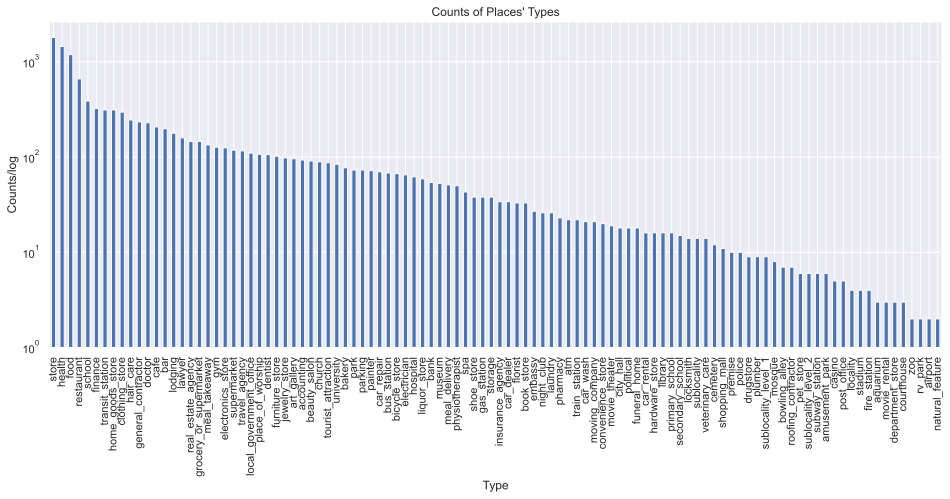

In [8]:
df_google_map_points_count = df_google_map[location_type].apply(sum)
df_google_map_points_count = df_google_map_points_count.drop(['establishment', 'point_of_interest']).sort_values(ascending=False)
ax = df_google_map_points_count.plot.bar(figsize=(16,6),log=True)
ax.set_title('Counts of Places\' Types')
ax.set_xlabel('Type')
ax.set_ylabel('Counts/log')
plt.show()

### 1.3.3 Calculate the number of various types of points within a certain range 

#### Firstly, the function of calculate the distance with lat and lng.

In [9]:
# now try to counting the number of different type points 
# copenhagen : lat:55.6761° N,  lng: 12.5683° E
from math import radians, cos, sin, asin, sqrt
def geodistance(lng1,lat1,lng2,lat2):
    lng1, lat1, lng2, lat2 = map(radians, [lng1, lat1, lng2, lat2])
    dlon=lng2-lng1
    dlat=lat2-lat1
    a=sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2 
    dis=2*asin(sqrt(a))*6371*1000
    return dis


RADIUS = 300
## =========================================================BEGINNING==========================================================
## the following codes are used to calculate the amount of different types of location within a concrete raidus here
## it takes too long time to run, so I saved the result as a csv file. Only need to read the csv file we could get the result
#
#
# df_parkomat_count = df_parkomat.copy()
# # df_parkomat_count.insert(0,'Count_radius_300m',0)
# list_column_parkomat_count = location_type.copy()
# list_column_parkomat_count.add('wkb_geometry')
# list_column_parkomat_count.add('['parkomat_id']')
# df_parkomat_count = df_parkomat_count[list_column_parkomat_count]
# # df_parkomat_count['wkb_geometry']
# df_parkomat_count['lng']  = df_parkomat_count['wkb_geometry'].map(lambda x:(re.split('POINT \(| |\)',x)[1]))
# df_parkomat_count['lat']  = df_parkomat_count['wkb_geometry'].map(lambda x:(re.split('POINT \(| |\)',x)[2]))


# for j in range(len(df_parkomat_count)):
#     print(j)
#     list_index_find = []
#     for i in range(len(df_google_map)):
#         distance = geodistance(df_google_map[i:i+1]['lng'],df_google_map[i:i+1]['lat'],df_parkomat_count[j:j+1]['lng'],df_parkomat_count[j:j+1]['lat'])
#         if(distance <= RADIUS):
#             list_index_find.append(i)
#     df_parkomat_count.loc[j,location_type]=df_google_map.loc[list_index_find,location_type].sum()
#     if(j%100==0):
#         df_parkomat_count.to_csv('df_parkomat_count_300m.csv')

# df_parkomat_count.to_csv('df_parkomat_count_300m.csv')

## =============================================================END===============================================================
df_parkomat_count = pd.read_csv("data_generated_by_wenjie/df_parkomat_count_300m.csv",index_col=0)



Now the `df_parkmot_count` contains the count of every type within a certain radius(300m)

In [10]:
df_parkomat_count.head()

,book_store,supermarket,church,hair_care,shoe_store,bicycle_store,local_government_office,primary_school,id,sublocality_level_2,...,car_wash,electrician,beauty_salon,drugstore,aquarium,police,roofing_contractor,lng,lat,parkomat_id
0,3,0,2,1,1,1,0,0,467,0,...,0,0,0,0,0,0,0,12.572666,55.679003,152
1,4,0,2,1,1,1,0,0,466,0,...,0,0,0,0,0,0,0,12.572937,55.679216,153
2,1,1,0,1,2,1,3,0,470,0,...,0,0,2,0,0,0,0,12.566108,55.677827,156
3,1,1,0,1,2,1,4,0,471,0,...,0,0,4,0,0,0,0,12.565577,55.678517,157
4,1,0,1,1,2,1,4,0,472,0,...,0,0,4,0,0,0,0,12.566308,55.679171,158


### 1.3.4 Working with the `df_transaction`
`df_transaction` is really an important dataset. Through the temporal and spacial distribution of transaction data, we can get the frequency and density of parking at different times and regions.


In [11]:
# Firstly We sort the transaction data by the id of the machine and the start time.
df_transaction_temp = df_transaction.sort_values(by=['Automat','Dato/tid parkeringsstart','Dato/tid parkeringsslut'])

# Then filter all the dirty data.
df_transaction_now_using = df_transaction_temp[(df_transaction_temp['Dato/tid parkeringsslut']-df_transaction_temp['Dato/tid parkeringsstart'])>=pd.Timedelta(0,'s')]

# Then calculate the minutes of stopping 
df_transaction_now_using.loc[:,'diff_time'] = (df_transaction_now_using['Dato/tid parkeringsslut'] - df_transaction_now_using['Dato/tid parkeringsstart']).dt.seconds/60
df_transaction_now_using.loc[:,'start_hour'] = df_transaction_now_using['Dato/tid parkeringsstart'].dt.hour
df_transaction_now_using.loc[:,'leave_hour'] = df_transaction_now_using['Dato/tid parkeringsslut'].dt.hour

df_transaction_now_using.head()

/Users/elias/pyEnv/socialdata/lib/python3.9/site-packages/pandas/core/indexing.py:1597: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = value
/Users/elias/pyEnv/socialdata/lib/python3.9/site-packages/pandas/core/indexing.py:1676: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(ilocs[0], value, pi)


,Sættype,Betalingsmåde,Automat,Lokation,Zone,Dato/tid parkeringsstart,Dato/tid parkeringsslut,Beløb,Kreditkortgebyr,diff_time,start_hour,leave_hour
676,Betaling,Mønter,152,NaN,? - ?,2015-01-01 18:05:00,2015-01-02 08:02:00,"1,00 DKK","0,00 DKK",837.0,18,8
1130,Betaling,Mønter,152,NaN,? - ?,2015-01-01 23:41:00,2015-01-02 08:02:00,"1,00 DKK","0,00 DKK",501.0,23,8
1283,Betaling,Mønter,152,NaN,? - ?,2015-01-02 05:18:00,2015-01-02 12:08:00,"124,00 DKK","0,00 DKK",410.0,5,12
2967,Betaling,VISA Dankort,152,NaN,? - ?,2015-01-02 09:35:00,2015-01-02 10:45:00,"35,00 DKK","0,50 DKK",70.0,9,10
3002,Betaling,Mønter,152,NaN,? - ?,2015-01-02 09:36:00,2015-01-02 14:56:00,"160,00 DKK","0,00 DKK",320.0,9,14


In [12]:
# Then Calculate the counts of starting and leaving per hour.

df_transaction_start_hour_count = df_transaction_now_using.groupby(['start_hour','Automat']).size().reset_index(name='counts')
df_transaction_start_hour_count = df_transaction_start_hour_count.rename(columns={"Automat":"parkomat_id"})


df_transaction_leave_hour_count = df_transaction_now_using.groupby(['leave_hour','Automat']).size().reset_index(name='counts')
df_transaction_leave_hour_count = df_transaction_leave_hour_count.rename(columns={"Automat":"parkomat_id"})

# df_transaction_start_hour_count[df_transaction_start_hour_count['start_hour']==0]

In [13]:
## This sector is used to calculate how many cars parking in every park per hour.(Different from above module.)
## ============================================BEGIN===========================
# time = pd.to_datetime("2015-01-01 00:00:00")
# df_transaction_hour_series =pd.DataFrame({'Automat':[],'counts':[],'datetime':[]})
# while time<pd.to_datetime("2016-01-01 00:00:00"):
#     temp = df_transaction[(df_transaction['Dato/tid parkeringsstart']<=time+pd.Timedelta(1,'h'))&(df_transaction['Dato/tid parkeringsslut']>=time)].groupby(['Automat']).size().reset_index(name='counts')
#     temp['datetime'] = time
#     time = time + pd.Timedelta(1,'h')
#     df_transaction_hour_series = df_transaction_hour_series.append(temp)
#     print(time)
## ====================================END=================================
df_transaction_hour_series = pd.read_csv("data_generated_by_wenjie/df_transaction_hour_series.csv",usecols=['Automat','counts','datetime'],parse_dates=['datetime'])

In [14]:
# Then calculate the percentage of parking using 
## ====================================BEGINNING===========================
# series_max_parking_count = df_transaction_hour_series.groupby(['Automat']).max().reset_index('Automat')
# series_max_parking_count = series_max_parking_count[['Automat','counts']]
# series_max_parking_count.rename(columns={'counts':'max_counts'},inplace=True)

# df_transaction_hour_series = df_transaction_hour_series.merge(series_max_parking_count,how='inner',on='Automat')
# df_transaction_hour_series['rate'] = df_transaction_hour_series['counts']/df_transaction_hour_series['max_counts']
## ==================================ENDING================================
df_transaction_hour_series = pd.read_csv('data_generated_by_wenjie/df_transaction_hour_series_with_rate.csv',usecols=['Automat','counts','datetime','max_counts_x','rate'],parse_dates=['datetime'])
df_transaction_hour_series.head()

,Automat,counts,datetime,max_counts_x,rate
0,157.0,1.0,2015-01-01 00:00:00,49.0,0.020408
1,157.0,2.0,2015-01-01 01:00:00,49.0,0.040816
2,157.0,3.0,2015-01-01 02:00:00,49.0,0.061224
3,157.0,3.0,2015-01-01 03:00:00,49.0,0.061224
4,157.0,3.0,2015-01-01 04:00:00,49.0,0.061224


# 2.Outline of Story
## 2.1 Basic Info Visualization
### 2.1.1 The Distribution of Machines

The first map is the distribution of Machines on 2015-05-21 00:00:00.
The color represents the occupancy rate.
Then according to the change of time, it is clear that not every


In [15]:
import folium
import re
import colorsys

# @ datetime_using: the time you want to show. Its format is 'xxxx-xx-xx xx:00:00'.It will show how many cars are parking in every point per hour.(For example, if it is 15:00:00, it shows the amount during 15-16)
# @ triple_rate: Sometimes (6:00) all parking points shows green if you just show it's true value. If we make the rate*3,the comparsion would be more clear.
def draw_parking_rate_according_to_datetime(datetime_using,triple_rate=False):
    df_transaction_temp = df_transaction_hour_series[df_transaction_hour_series['datetime']==datetime_using].merge(df_parkomat_count,how='inner',left_on='Automat',right_on='parkomat_id')
    cp_map = folium.Map(location=[55.6760968, 12.5683371], zoom_start=13)
    for i in range(len(df_transaction_temp)):
        rate = int(df_transaction_temp[i:i+1]['rate']*100)
        if triple_rate:
            rate = rate*2
        if rate > 100:
            rate = 100
        rgb = colorsys.hsv_to_rgb((100 -rate)/ 300., 1.0, 1.0)
        color = '#%02x%02x%02x' % tuple([round(255*x) for x in rgb])
        folium.Circle(
            radius=5,
            location=[df_transaction_temp[i:i+1]['lat'], df_transaction_temp[i:i+1]['lng']],
            color=color,
            fill=True
        ).add_to(cp_map)
    return cp_map

# get a time you want
datetime_using = pd.to_datetime("2015-05-21 00:00:00")
# draw all the point
cp_map = draw_parking_rate_according_to_datetime(datetime_using,True)
cp_map

In [16]:
# Parking count in each hour with location
parking_count = df_transaction_hour_series.merge(df_parkomat_count,how='inner',left_on='Automat',right_on='parkomat_id')

# Here I calculate average value of every parking point over the whole year.
df_transaction_hour_series['hour'] = df_transaction_hour_series['datetime'].dt.hour
df_transaction_hour_series['weekday'] = df_transaction_hour_series['datetime'].dt.weekday
df_transaction_average = df_transaction_hour_series.groupby(by=['Automat']).mean().reset_index(['Automat'])
df_transaction_average.head(10)

parking_count.to_csv(r'./heatmap/parking_count.csv', index=False)
df_transaction_average.to_csv(r'./heatmap/df_transaction_average.csv', index=False)

In [32]:
parking_count = pd.read_csv('./heatmap/parking_count.csv', parse_dates=['datetime'])
df_transaction_average = pd.read_csv('./heatmap/df_transaction_average.csv')

from folium import plugins

cp_map = folium.Map(location=[55.6760968, 12.5683371], zoom_start=13)

for index, row in parking_count.drop_duplicates(subset=['Automat']).iterrows():
    popup = df_parkomat.loc[df_parkomat['parkomat_id'] == row['Automat'], 'vejnavn'].iloc[0]
    folium.Circle(
        radius=5,
        location=[row['lat'], row['lng']],
        color='cadetblue',
        popup=popup,
        fill=True
    ).add_to(cp_map)

heat_data = []
labels = []
for i in range(24, 48): # 24 - 48 means 24 hours of Tuesday
    # date range used to figure out the hot spot
    times = [d.date().strftime('%Y-%m-%d') for d in pd.date_range(start="2015-05-10", end="2015-05-16") if d.weekday() == i//24]
    for j in range(len(times)):
        times[j] = times[j] + " " + str(i%24) + ":00"
        times[j] = pd.to_datetime(times[j], format='%Y-%m-%d %H:%M')
    frame = []
    for time in times:
        for index, row in parking_count.loc[(parking_count['datetime'] == time)].iterrows():
            if row['counts']/1.7 > df_transaction_average.loc[df_transaction_average['Automat'] == row['Automat'], 'counts'].item():
                frame.append([row['lat'],row['lng']])
    heat_data.append(frame)
    labels.append(times[0].day_name() + ' ' + times[0].strftime('%H:%M'))

hm = plugins.HeatMapWithTime(heat_data, radius=12, index=labels)
hm.add_to(cp_map)
cp_map

### 2.1.2 The visualization of Geo info from google_map
Points with different colors represent different types of types.

In [18]:
# This section is used to generate different color according to string
# I want to draw all the points from google_map on the same map. So we could use different colors to determine different types.
# For example, the string "['food','book']" would be yellow and string "['shop','station']" would be green.
import hashlib

def hsv2rgb(h, s, v):
    h += 0.618033988749895
    h %= 1
    h_i = int(h*6)
    f = h*6 - h_i
    p = v * (1 - s)
    q = v * (1 - f*s)
    t = v * (1 - (1 - f) * s)

    if h_i == 0:
        r, g, b = v, t, p
    elif h_i == 1:
        r, g, b = q, v, p
    elif h_i == 2:
        r, g, b = p, v, t
    elif h_i == 3:
        r, g, b = p, q, v
    elif h_i == 4:
        r, g, b = t, p, v
    elif h_i == 5:
        r, g, b = v, p, q
    else:
        r = g = b = 0
    return [int(r*256), int(g*256), int(b*256)]

def str2rgb(obj):
    digest = hashlib.sha384(str(obj).encode('utf-8')).hexdigest()

    sub_size = int(len(digest) / 3)
    max_value = float(int("f" * sub_size, 16))
    digests = [digest[i * sub_size: (i + 1) * sub_size] for i in range(3)]

    rgb = (((int(d, 16) / max_value)+0.618033988749895) % 1 for d in digests)

    return '#' + ''.join(["%02x" % int(c*255 + 0.5 - 0.0000005) for c in rgb])

def str2rgb2(obj):
    digest = hashlib.sha384(str(obj).encode('utf-8')).hexdigest()

    obj_value = int(digest, 16)
    max_value = float(int("f" * len(digest), 16))

    rgb = hsv2rgb(obj_value/max_value, 0.5, 0.95)

    return '#' + ''.join(["%02x" % c for c in rgb])

In [19]:
# here I show all the points from google_map
def draw_map_with_google_map_points():
    cp_map = folium.Map(location=[55.6760968, 12.5683371], zoom_start=13)
    for i in range(len(df_google_map)):
        if not str(df_google_map.loc[i,'type'])=="[\'point_of_interest\', \'establishment\']":
            folium.Circle(
            radius=3,
            location=[df_google_map.loc[i,'lat'], df_google_map.loc[i,'lng']],
            color=str2rgb2(str(df_google_map.loc[i,'type'])),
            fill=True
        ).add_to(cp_map)
    return cp_map
cp_map = draw_map_with_google_map_points()
cp_map

### 2.1.3 Analysis Time-Series Trends of Every Parking 

In [20]:
# Here I calculate average value per hour of every parking point.
df_transaction_hour_series['hour'] = df_transaction_hour_series['datetime'].dt.hour
df_transaction_hour_series_avarage =df_transaction_hour_series.groupby(by=['Automat','hour']).mean().reset_index(['Automat','hour'])

In [21]:

import matplotlib.pyplot as plt
import seaborn as sns
sns.set()

figure, ax = plt.subplots(nrows=153,ncols=2,figsize=(10,500))
count = 0
for i in list(df_transaction_hour_series_avarage['Automat'].drop_duplicates()):
    ax[count//10,0].plot(list(df_transaction_hour_series_avarage[df_transaction_hour_series_avarage['Automat']==i]['counts']))
    ax[count//10,1].plot(list(df_transaction_hour_series_avarage[df_transaction_hour_series_avarage['Automat']==i]['rate']))
    count = count + 1 





According to the figures, It is clearly that the parking rates show similar trend with it own counts.
But for different parking stations, the trends should be compeletely different.

So which factors would result in these differences?

## 2.2 Explore potentional factors

First of all, let's see the following map:

We could easily find that on this map there are a lot of different types of locations around the green markers(i.e. the parking area).
So we could try to calculate the number of different types of locations within a radius(300m in our project) to explore the influences.

In [22]:
cp_map = draw_map_with_google_map_points()
point_index_list = [0,300,390,460,550,202,777,999,665,1234]
for i in point_index_list:
    folium.Marker(
    location=[df_parkomat_count.loc[i,'lat'],df_parkomat_count.loc[i,'lng']],
    icon=folium.Icon(color="green")
).add_to(cp_map)
cp_map

Then we will use the Random Forests to prophet the results.

In [23]:
df_random_forest = df_transaction_hour_series_avarage[['Automat','hour','rate']]
# Get one hot encoding of columns B
one_hot = pd.get_dummies(df_random_forest['hour'])
# Drop column B as it is now encoded
df_random_forest = df_random_forest.drop('hour',axis = 1)
# Join the encoded df
df_random_forest = df_random_forest.join(one_hot)
df_random_forest = df_random_forest.merge(df_parkomat_count,how = 'inner',left_on ='Automat',right_on='parkomat_id')
df_random_forest.drop('parkomat_id',axis=1)

,Automat,rate,0,1,2,3,4,5,6,7,...,gym,car_wash,electrician,beauty_salon,drugstore,aquarium,police,roofing_contractor,lng,lat
0,152.0,0.245343,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,12.572666,55.679003
1,152.0,0.237295,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,12.572666,55.679003
2,152.0,0.233484,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,12.572666,55.679003
3,152.0,0.224083,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,12.572666,55.679003
4,152.0,0.211088,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,12.572666,55.679003
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35529,9625.0,0.211312,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,12.567071,55.691890
35530,9625.0,0.209009,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,12.567071,55.691890
35531,9625.0,0.212255,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,12.567071,55.691890
35532,9625.0,0.207107,0,0,0,0,0,0,0,0,...,2,0,0,0,0,0,0,0,12.567071,55.691890


In [24]:
def randomForest(X,y,X_test,y_test):
# Instantiate model with 1000 decision trees
    rf = RandomForestRegressor(n_estimators = 300, random_state = 40)
# Train the model on training data
    rf.fit(X, y)
#test 
    predictions = rf.predict(X_test)
# Calculate the absolute errors
    errors = abs(predictions - y_test)
# Print out the mean absolute error (mae)
    print('Mean Absolute Error:', round(np.mean(errors), 2), 'degrees.')
# Calculate mean absolute percentage error (MAPE)
    mape = 100 * (errors / y_test)
# Calculate and display accuracy
    accuracy = 100 - np.mean(mape)
    print('Accuracy:', round(accuracy, 2), '%.')
    return rf
# ###############################################################
train = df_random_forest.drop(
        columns=['Automat','parkomat_id','rate',
        'id',
        'lng',
        'lat',
        'sublocality_level_2',
        'sublocality_level_1',
        'sublocality',
        'establishment',
        'point_of_interest',
        'wkb_geometry'])
target = df_random_forest['rate']
X,X_test, y, y_test = sklearn.model_selection.train_test_split(train,target,train_size = int(len(train)*0.9),random_state = 0)
res =  randomForest(X,y,X_test,y_test)


Mean Absolute Error: 0.02 degrees.
Accuracy: 89.24 %.


In [25]:
train = df_random_forest.drop(
        columns=['Automat','parkomat_id','rate',
        'id',
        'lng',
        'lat',
        'sublocality_level_2',
        'sublocality_level_1',
        'sublocality',
        'establishment',
        'point_of_interest',
        'wkb_geometry']).columns

random_forest_weight = res.feature_importances_
random_forest_weight = pd.DataFrame({'attributes':train,'weight':random_forest_weight})
random_forest_weight


,attributes,weight
0,0,0.000841
1,1,0.000688
2,2,0.000643
3,3,0.000720
4,4,0.000707
...,...,...
120,beauty_salon,0.008313
121,drugstore,0.000881
122,aquarium,0.002653
123,police,0.004182


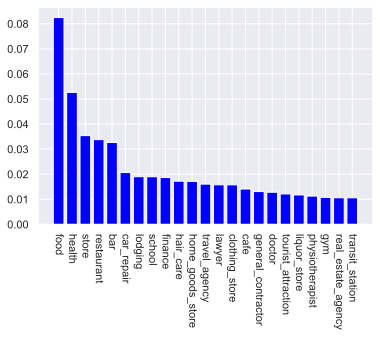

<Figure size 72000x72000 with 0 Axes>

In [26]:
# Here I show the prority of every attribute
# I drop all the arribute of time because we only focus on the geo info
# But if you want ,you could also print them to underline which time would be more busy.

temp = random_forest_weight.sort_values('weight',ascending=False)
temp = temp[temp['weight']>=0.01]
temp = temp.drop(index=temp[temp['attributes'].isin({14,13,12,15,11,16,19,10,9,20,17,8,18})].index)
name_list = list(temp['attributes'])
num_list = list(temp['weight'])
plt.bar(range(len(num_list)), num_list,color='blue',tick_label=name_list)
plt.xticks(rotation=270) 
plt.figure(figsize=(1000,1000))
plt.show()



In [27]:
# for i in range(24):
#     df_now_using = df_transaction_start_hour_count[df_transaction_start_hour_count['start_hour']==(i)]
#     df_now_using = df_now_using.merge(df_parkomat_count,how='inner',on = 'parkomat_id')
#     train = df_now_using.drop(
#         columns=['start_hour',
#         'parkomat_id',
#         'id',
#         'counts',
#         'lng',
#         'lat',
#         'sublocality_level_2',
#         'sublocality_level_1',
#         'sublocality',
#         'establishment',
#         'point_of_interest',
#         'wkb_geometry'])
#     target = df_now_using['counts']
#     X,X_test, y, y_test = sklearn.model_selection.train_test_split(train,target,train_size = int(len(train)*0.9),random_state = 0)
#     print("start:",i)
#     randomForest(X,y,X_test,y_test)



In [28]:
# for i in range(24):
#     df_now_using = df_transaction_leave_hour_count[df_transaction_leave_hour_count['leave_hour']==(i)]
#     df_now_using = df_now_using.merge(df_parkomat_count,how='inner',on = 'parkomat_id')
#     train = df_now_using.drop(
#         columns=['leave_hour',
#         'parkomat_id',
#         'id',
#         'counts',
#         'lng',
#         'lat',
#         'sublocality_level_2',
#         'sublocality_level_1',
#         'sublocality',
#         'establishment',
#         'point_of_interest',
#         'wkb_geometry'])
#     target = df_now_using['counts']
#     X,X_test, y, y_test = sklearn.model_selection.train_test_split(train,target,train_size = int(len(train)*0.9),random_state = 0)
#     print("start:",i)
#     randomForest(X,y,X_test,y_test)


In [29]:
## =========DRAWING MAPS===================================
# # # test = literal_eval(df_parking[0:1]['wkb_geometry'])
# # t = (df_parking.loc[6581,['wkb_geometry']])['wkb_geometry']
# # point_around = df_google_map
# # point_around = point_around.drop(index=point_around.index)
# # for point1 in t:
# #     for point2 in df_google_map:
# # len(df_parkomat)
# #1602
# df_parkomat.head()
# df_parkomat['wkb_geometry'][1]
# # df_parkomat['lat'] = df_parkomat['wkb_geometry'].apply(lambda x: x.)
# import re
# t = re.split('POINT \(| |\)',df_parkomat['wkb_geometry'][1])[1:3]

# def strpoint_to_list(str):
#     temp_list=[]

# df_parking = pd.read_csv("taelling_p_pladser.csv", parse_dates=['aar_mdr'])
# df_parking = df_parking[(df_parking['aar_mdr']>='2012') & (df_parking['aar_mdr']<='2021')]
# df_parking = df_parking.sort_values(by='aar_mdr')
# # df_parking = df_parking[df_parking.aar_mdr != '201  405']
# df_parking['aar_mdr'] = df_parking['aar_mdr'].apply(lambda x: str(x)).apply(lambda x : x[:4]+'/'+x[4:])
# def format_geo(x):
#     x = str(x)
#     for i in ")(,":
#         x = x.replace(i,'')
#     x = x.split()[1:]
#     locations = []
#     for i in range(0,len(x),2):
#         locations.append(x[i:i+2])
#     return locations
# df_parking['wkb_geometry'] = df_parking['wkb_geometry'].apply(format_geo)

In [30]:
# import folium
# cp_map = folium.Map(location=[55.6760968, 12.5683371], zoom_start=13)
# for i in range(len(df_google_map)):
#     folium.Circle(
#         radius=1,
#         location=[df_google_map.loc[i,'lat'], df_google_map.loc[i,'lng']],
#         color="blue",
#         fill=True
#     ).add_to(cp_map)

# for i in range(len(df_parkomat)):
#     t = re.split('POINT \(| |\)',df_parkomat['wkb_geometry'][i])[1:3]
#     # folium.Circle(
#     #     radius=3,
#     #     location=[t[1], t[0]],
#     #     color="green",
#     #     fill=True
#     # ).add_to(cp_map)
#     folium.Marker(
#     location=[t[1], t[0]],
#     icon=folium.Icon(color="green")
# ).add_to(cp_map)



# df_201703 = df_parking[df_parking['aar_mdr'] == '2017/03']
# df_201703 = df_201703.dropna(subset=['wkb_geometry'])
# df_201703 = df_201703[df_201703['wkb_geometry'].apply(lambda x: len(x)) > 0]
# df_201703 = df_201703[df_201703['lovlig_p_kl_12']!=0]
# df_201703 = df_201703[df_201703['lovlig_p_kl_17']!=0]
# df_201703 = df_201703[df_201703['lovlig_p_kl_22']!=0]
# df_201703 = df_201703.drop_duplicates(subset=['taelle_id'], keep='first')

# import colorsys

# for i, row in df_201703.iterrows():
#     points = []
#     if len(row['wkb_geometry']) == 0:
#         continue
#     rate = int(row['belaegning_kl_12_pct'])
#     if rate > 100:
#         rate = 100
#     rgb = colorsys.hsv_to_rgb((100 -rate)/ 300., 1.0, 1.0)
#     color = '#%02x%02x%02x' % tuple([round(255*x) for x in rgb])
#     for location in row['wkb_geometry']:
#         point = []
#         point.append(float(location[1]))
#         point.append(float(location[0]))
#         points.append(point)
#     popup = row['vejnavn'] + '-' + str(rate) + '%'
#     folium.PolyLine(points, color=color, popup=popup).add_to(cp_map)


# cp_map